In [1]:
import pandas as pd
import numpy as np
import gzip
import json
import plotly.io as pio
pio.renderers.default='notebook'

In [152]:
%%HTML
<script src="require.js"></script>

In [12]:
meta_df_1000 = pd.read_parquet('meta_df_1000_cleaned.parquet')
reviews_df = pd.read_parquet('reviews_df_clean.parquet')

In [3]:
categories_arr1 = meta_df_1000.category.apply(lambda x: x[1])
categories_arr2 = meta_df_1000.category.apply(lambda x: x[2] if len(x)>=3 else None)

In [4]:
categories_arr1

158       eBook Readers & Accessories
243            Accessories & Supplies
947            Accessories & Supplies
1336          Computers & Accessories
2327           Accessories & Supplies
                     ...             
780642                     Headphones
781908        Computers & Accessories
782902        Computers & Accessories
783568      Car & Vehicle Electronics
785453        Computers & Accessories
Name: category, Length: 786, dtype: object

In [6]:
import plotly.express as px
fig = px.histogram(categories_arr1, x='category', text_auto=True)
fig.update_layout(
    title_text='Frequencies of 1st sub-categories within Electronics'
)
fig.show()

In [8]:
fig.write_html('plot_cat_hist.html',
                full_html=False,
                include_plotlyjs='cdn')

In [11]:
reviews_df

,title,content,date,author,rating,found_helpful,verified_purchase,product
0,Good case but the zipper is not good at all.,This case looks very durable and it is easy to...,2012-02-05,psp,2.0,0,True,Black EVA Protective Cube Carrying Case with M...
1,Battery arrived in new condition at about half...,Battery arrived in new condition at about half...,2016-11-12,Brian B,4.0,1,True,NinjaBatt Laptop Battery for Apple A1321 A1286...
2,DoA and poor quality,"Doesn't show ""charging"" or battery present in ...",2017-03-30,D. McIver,2.0,0,True,NinjaBatt Laptop Battery for Apple A1321 A1286...
3,and the battery arrived in great shape. I had ...,I bought this as replacement for the factory b...,2016-05-27,SethB,5.0,1,True,NinjaBatt Laptop Battery for Apple A1321 A1286...
4,Great Replacement Battery!,I had to replace my Macbook Pro battery (mid 2...,2016-05-04,Corey H,5.0,1,True,NinjaBatt Laptop Battery for Apple A1321 A1286...
...,...,...,...,...,...,...,...,...
5916,a great DVD!,Really nice disks. Burn at up to 12x with no p...,2006-03-16,Teapot Tales,5.0,19,True,Verbatim DVD-R 4.7GB 16X DataLifePlus Shiny Si...
5917,Great 8x media,"Out of all the DVD-R media I've used, these Ve...",2006-06-27,Musubi,5.0,4,True,Verbatim DVD-R 4.7GB 16X DataLifePlus Shiny Si...
5918,They've been dependable for me.,I've had very few failed disks with this brand...,2019-08-10,RR M,4.0,0,True,Verbatim DVD-R 4.7GB 16X DataLifePlus Shiny Si...
5919,QUALITY,these are good quality discs,2021-02-14,gordon,5.0,0,True,Verbatim DVD-R 4.7GB 16X DataLifePlus Shiny Si...


In [13]:
merged_df = pd.merge(meta_df_1000, reviews_df, on='asin', how='inner')
merged_df['category_1'] = merged_df.category.apply(lambda x: x[1])
merged_df['rating'] = merged_df['rating'].astype(float)

In [1]:
fig = px.histogram(merged_df, x='category_1', y='rating', histfunc='avg', text_auto=True)
fig.update_layout(
    title_text='Mean rating over 1st sub-categories within Electronics'
)
fig.show()

NameError: name 'px' is not defined

In [17]:
fig.write_html('plot_avg_rating_cat.html',
                full_html=False,
                include_plotlyjs='cdn')

In [18]:
product_mean_rating = merged_df.groupby('asin')\
                        .agg(mean_rating=('rating', 'mean'), count=('asin', 'count'))\
                        .reset_index()
product_mean_rating = product_mean_rating.sort_values('count')
product_mean_rating

,asin,mean_rating,count
774,B01HFQS88M,5.00,1
591,B00RD5R468,4.00,1
472,B00GSU6FPU,5.00,1
586,B00Q799NJM,4.00,1
289,B005ODLA9S,2.00,1
...,...,...,...
88,B0002RSP5S,2.05,20
84,B0002KR7FY,3.45,20
83,B0002J2MZ0,4.50,20
214,B00387E5BW,4.60,20


In [19]:
fig = px.scatter(product_mean_rating, x='count', y='mean_rating', trendline="ols")
fig.update_layout(
    title_text='Product Mean rating vs Count of product reviews in the dataset'
)

In [20]:
fig.write_html('plot_rating_count_vs_mean_rating.html',
                full_html=False,
                include_plotlyjs='cdn')

In [7]:
!jupyter nbconvert --to html visualization.ipynb

[NbConvertApp] Converting notebook visualization.ipynb to html
[NbConvertApp] Writing 42706569 bytes to visualization.html


In [117]:
fig.write_html('plot1.html',
                full_html=False,
                include_plotlyjs='cdn')

In [25]:
fig = px.scatter(merged_df, x="rating", y='found_helpful', trendline='ols')
fig.update_layout(
    title_text='Scatter plot between found helpful and rating for each review'
)
fig.show()

In [26]:
fig.write_html('plot_found_helpful_vs_rating.html',
                full_html=False,
                include_plotlyjs='cdn')

In [61]:
value_counts = merged_df['found_helpful'].value_counts().iloc[:8].reset_index()
fig = px.bar(value_counts, x='found_helpful', y='index', orientation='h')
fig.update_layout(
    title_text='Freq of values in found_helpful'
)
fig.show()

In [62]:
fig.write_html('plot_found_helpful_freq.html',
                full_html=False,
                include_plotlyjs='cdn')

In [65]:
fig = px.density_heatmap(merged_df, x="verified_purchase", y="category_1", z="rating", histfunc="avg", marginal_x="histogram", marginal_y="histogram", text_auto=True)
fig.update_layout(
    title_text='Avg ratings for each value in verified_purcahse grouped by category'
)
fig.show()

In [66]:
fig.write_html('plot_verified_rating_heatmap.html',
                full_html=False,
                include_plotlyjs='cdn')

In [70]:
meta_df_1000['rank'].head(10)

158                                 [[Books , 3,563,332]]
243     [[Electronics > Accessories & Supplies > Audio...
947     [[Office Products , 60,771], [Electronics > Ac...
1336    [[Cell Phones & Accessories , 2,039,965], [Cel...
2327    [[Computers & Accessories > Computer Accessori...
2996    [[Electronics , 1,934,344], [Electronics > Com...
3127    [[Electronics > Accessories & Supplies > Compu...
3404    [[Cell Phones & Accessories , 257,500], [Compu...
3559    [[Electronics , 787,781], [Electronics > Porta...
4161    [[Camera & Photo , 7,981], [Electronics > Came...
Name: rank, dtype: object

In [71]:
rank_df = merged_df[['asin', 'rank', 'rating', 'category_1']].explode('rank')
rank_df = rank_df.dropna(subset='rank').reset_index(drop=True)
rank_df

,asin,rank,rating,category_1
0,0782494285,"[Books , 3,563,332]",1.0,eBook Readers & Accessories
1,0782494285,"[Books , 3,563,332]",5.0,eBook Readers & Accessories
2,0782494285,"[Books , 3,563,332]",5.0,eBook Readers & Accessories
3,0782494285,"[Books , 3,563,332]",5.0,eBook Readers & Accessories
4,1059844575,[Electronics > Accessories & Supplies > Audio ...,4.0,Accessories & Supplies
...,...,...,...,...
10882,B01H5KKVME,"[Computers & Accessories > Monitors, 1,401]",1.0,Computers & Accessories
10883,B01H7WQQ06,[Electronics > Car Electronics > Car Audio > S...,5.0,Car & Vehicle Electronics
10884,B01H7WQQ06,[Electronics > Car Electronics > Car Audio > S...,5.0,Car & Vehicle Electronics
10885,B01HFQS88M,"[Home & Kitchen , 5,893,814]",5.0,Computers & Accessories


In [72]:
rank_df = pd.concat([rank_df.drop(columns='rank'), pd.DataFrame(rank_df['rank'].to_list(), columns=['category', 'rank'])], axis=1)

In [74]:
rank_df['rank'] = rank_df['rank'].str.replace(',', '', regex=False).astype(float)


In [75]:
rank_df

,asin,rating,category_1,category,rank
0,0782494285,1.0,eBook Readers & Accessories,Books,3563332.0
1,0782494285,5.0,eBook Readers & Accessories,Books,3563332.0
2,0782494285,5.0,eBook Readers & Accessories,Books,3563332.0
3,0782494285,5.0,eBook Readers & Accessories,Books,3563332.0
4,1059844575,4.0,Accessories & Supplies,Electronics > Accessories & Supplies > Audio &...,4160.0
...,...,...,...,...,...
10882,B01H5KKVME,1.0,Computers & Accessories,Computers & Accessories > Monitors,1401.0
10883,B01H7WQQ06,5.0,Car & Vehicle Electronics,Electronics > Car Electronics > Car Audio > Sp...,4142.0
10884,B01H7WQQ06,5.0,Car & Vehicle Electronics,Electronics > Car Electronics > Car Audio > Sp...,4142.0
10885,B01HFQS88M,5.0,Computers & Accessories,Home & Kitchen,5893814.0


In [76]:
fig = px.box(rank_df[rank_df['rank'] < 1000000], x="category_1", y="rank", color="rating",
            category_orders={'rating': [5.0, 4.0, 3.0, 2.0, 1.0]})
fig.update_layout(
    title_text='Box plot for rank vs category grouped by each rating value'
)
fig.show()


In [77]:
fig.write_html('plot_rank_vs_category_rating.html',
                full_html=False,
                include_plotlyjs='cdn')

In [217]:
fig = px.box(rank_df[rank_df['rank'] < 500000], x="rating", y="rank", color='category_1',
            category_orders={'rating': [5.0, 4.0, 3.0, 2.0, 1.0]})
fig.show()


In [81]:
import nltk
import spacy
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib import rcParams
from wordcloud import WordCloud, STOPWORDS
%matplotlib inline

In [79]:
merged_df['content'].head(10)

0    didn't work... If I could've given it zero sta...
1    Gave as a gift to my brother who teaches Sunda...
2    I also love this reading light.  I've had mine...
3    I am buying the second one of these. I used th...
4                                          Worked well
5    I had given this item a 1 star and bad review ...
6    I have an LG G3 and love the quality of watchi...
7    Worked perfectly. One side goes into the LG G3...
8    not sure if this adapter is slowing down my ch...
9    The item is a great idea.  I had the same expe...
Name: content, dtype: object

In [82]:
nlp = spacy.load('en_core_web_sm')


In [117]:
merged_df['tokens'] = merged_df['content'].apply(lambda x: nlp(x.lower())) 
merged_df.tokens

0       (did, n't, work, ..., if, i, could, 've, given...
1       (gave, as, a, gift, to, my, brother, who, teac...
2       (i, also, love, this, reading, light, .,  , i,...
3       (i, am, buying, the, second, one, of, these, ....
4                                          (worked, well)
                              ...                        
5916    (i, love, this, monitor, !, i, went, through, ...
5917    (i, bought, this, turd, for, my, 2016, macbook...
5918    (i, installed, these, in, my, jeep, ., super, ...
5919    (great, sound, ., my, son, had, them, installe...
5920       (came, as, described, .,  , no, complaints, .)
Name: tokens, Length: 5921, dtype: object

In [118]:
merged_df.tokens.head(10)

0    (did, n't, work, ..., if, i, could, 've, given...
1    (gave, as, a, gift, to, my, brother, who, teac...
2    (i, also, love, this, reading, light, .,  , i,...
3    (i, am, buying, the, second, one, of, these, ....
4                                       (worked, well)
5    (i, had, given, this, item, a, 1, star, and, b...
6    (i, have, an, lg, g3, and, love, the, quality,...
7    (worked, perfectly, ., one, side, goes, into, ...
8    (not, sure, if, this, adapter, is, slowing, do...
9    (the, item, is, a, great, idea, .,  , i, had, ...
Name: tokens, dtype: object

In [119]:
merged_df['tokens'] = merged_df.tokens.apply(lambda x: [w.lemma_ for w in x if not w.is_stop and not w.is_punct and w.lemma_!=' '])
# for w in merged_df.tokens[0]:
#     print (w, w.lemma_, w.is_stop, w.is_punct)

In [120]:
merged_df['tokens'].head(10)

0                             [work, give, zero, star]
1    [give, gift, brother, teach, sunday, school, n...
2    [love, reading, light, 3, year, end, give, dau...
3    [buy, second, 1, half, year, travel, lot, carr...
4                                               [work]
5    [give, item, 1, star, bad, review, not, give, ...
6    [lg, g3, love, quality, watch, video, love, tr...
7    [work, perfectly, go, lg, g3, t, mobile, conne...
8    [sure, adapter, slow, charger, tablet, battery...
9    [item, great, idea, experience, device, flash,...
Name: tokens, dtype: object

In [121]:
word_freq_df = merged_df[['category_1', 'tokens']].explode('tokens').reset_index(drop=True)\
            .groupby(['category_1', 'tokens']).agg(count=('category_1', 'count')).reset_index().sort_values('count', ascending=False)

In [122]:
word_freq_df[word_freq_df['tokens']=='one']

,category_1,tokens,count
19058,Computers & Accessories,one,53
9100,Camera & Photo,one,38
3103,Accessories & Supplies,one,34
25221,Headphones,one,28
34258,Television & Video,one,10
12826,Car & Vehicle Electronics,one,6
30125,Portable Audio & Video,one,5
27589,Home Audio,one,5
32197,Security & Surveillance,one,2
35393,Video Projectors,one,1


In [123]:
tokens_df = merged_df[['category_1', 'tokens']].copy()
tokens_df['tokens'] = tokens_df['tokens'].apply(lambda x: ' '.join(x))
category_tokens = tokens_df.groupby('category_1').tokens.agg(lambda x: ' '.join(x.to_list()))

In [124]:
category_tokens.index

Index(['Accessories & Supplies', 'Camera & Photo', 'Car & Vehicle Electronics',
       'Computers & Accessories', 'Electronics Warranties',
       'GPS, Finders & Accessories', 'Headphones', 'Home Audio',
       'Portable Audio & Video', 'Security & Surveillance',
       'Television & Video', 'Video Projectors', 'Wearable Technology',
       'eBook Readers & Accessories'],
      dtype='object', name='category_1')

In [317]:
wordcloud = WordCloud(stopwords=STOPWORDS, background_color="white", max_words=1000, min_font_size=2).generate(' '.join(merged_df.content.to_list()))

Accessories & Supplies


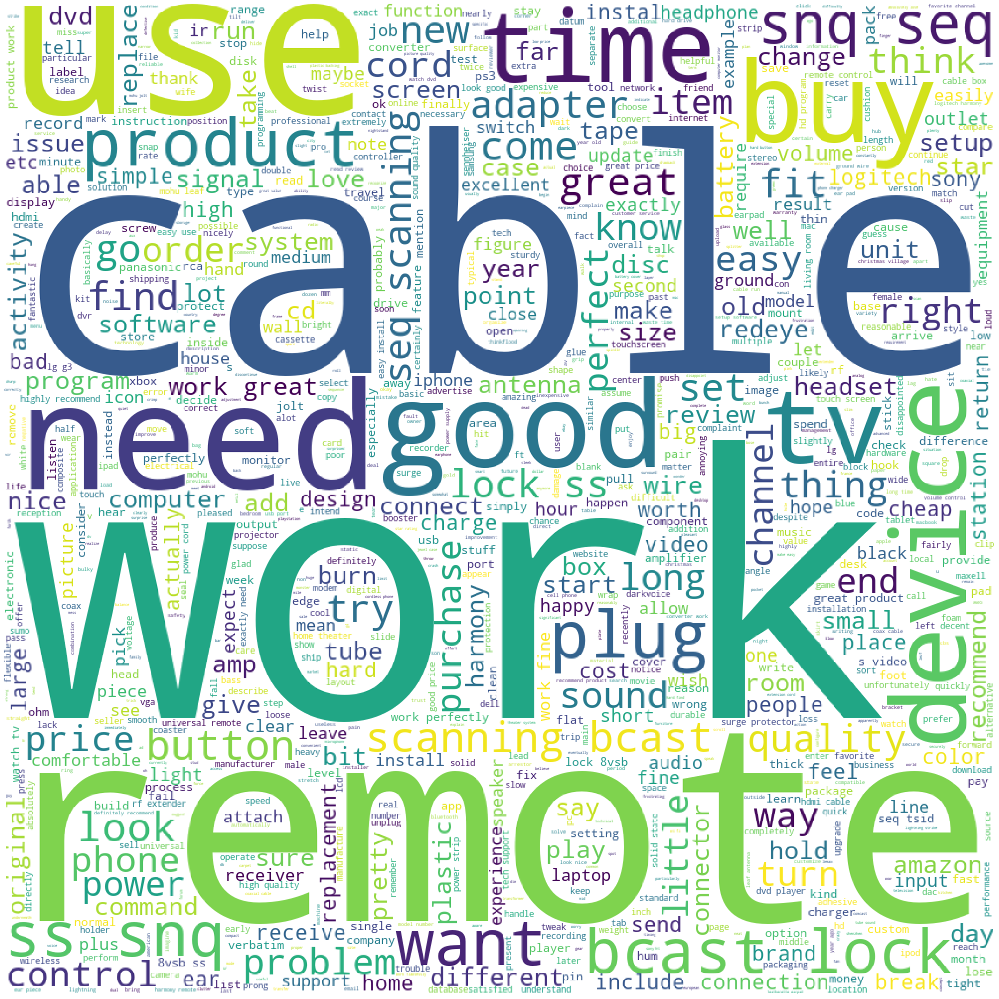

Camera & Photo


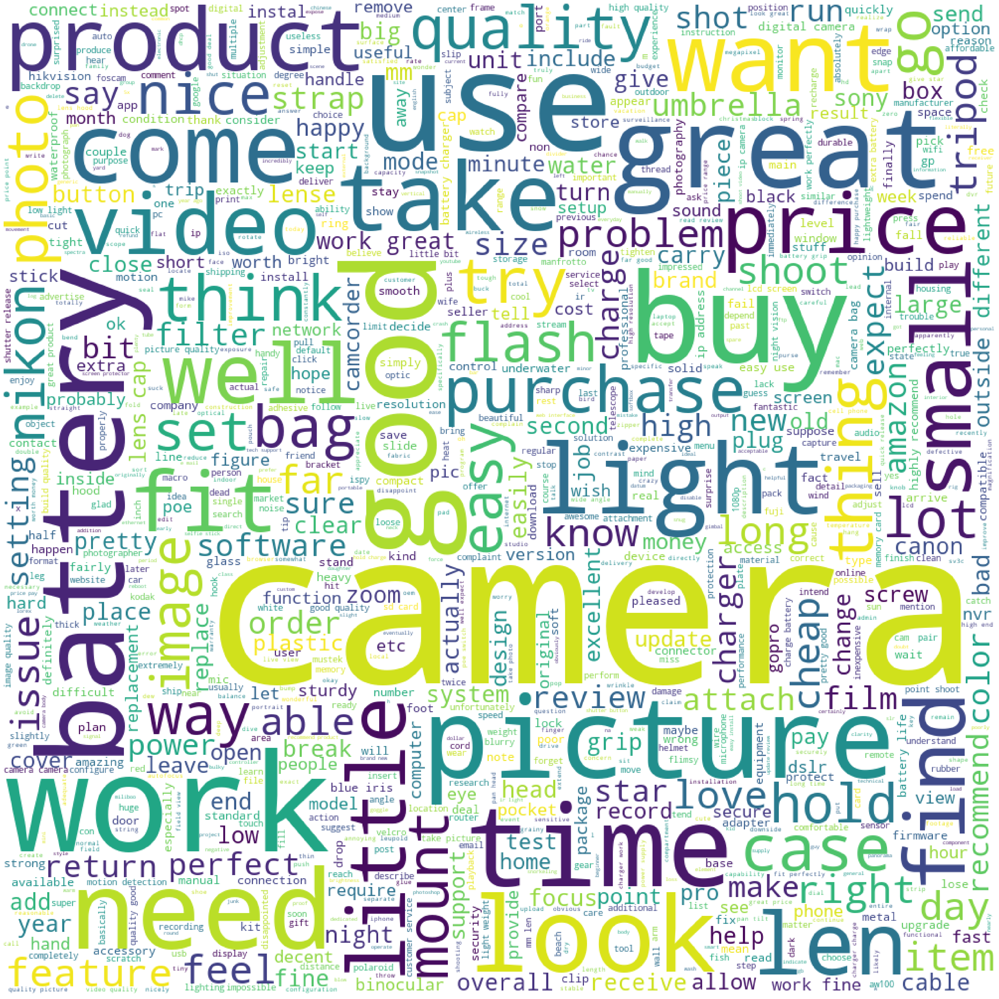

Car & Vehicle Electronics


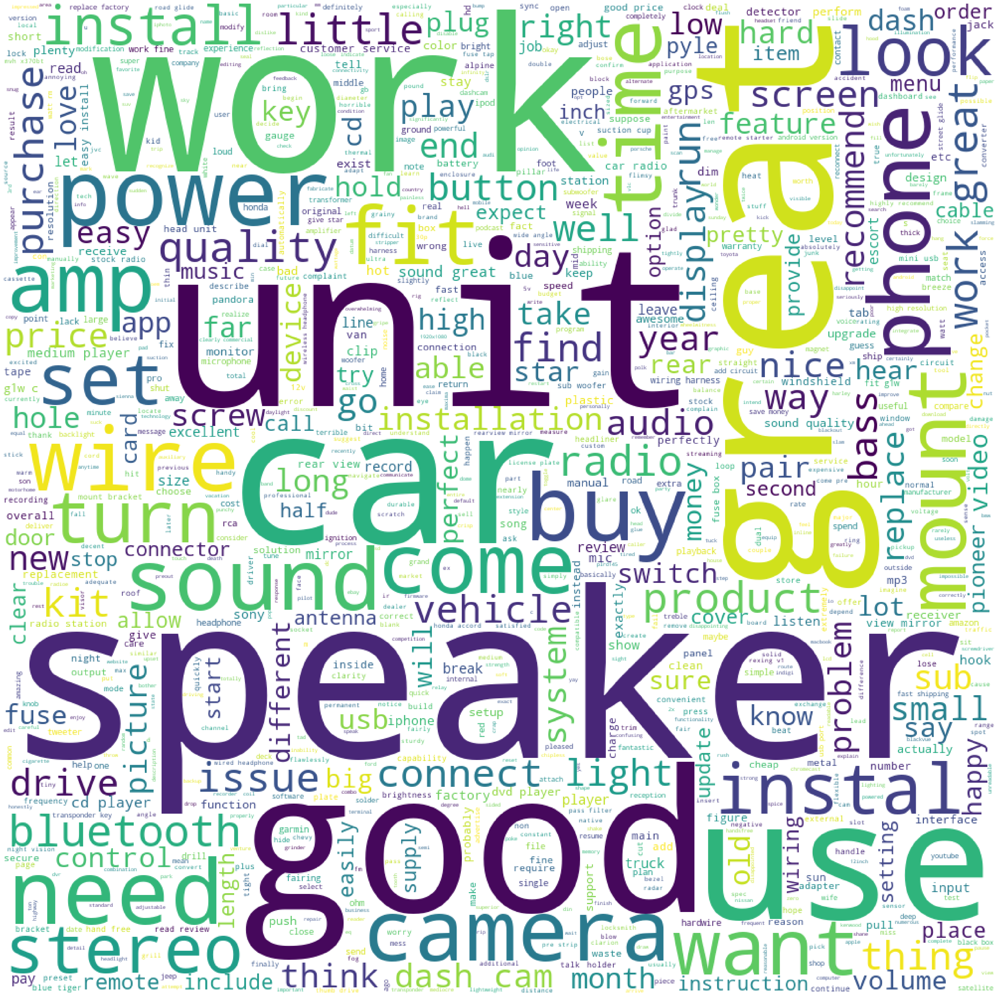

Computers & Accessories


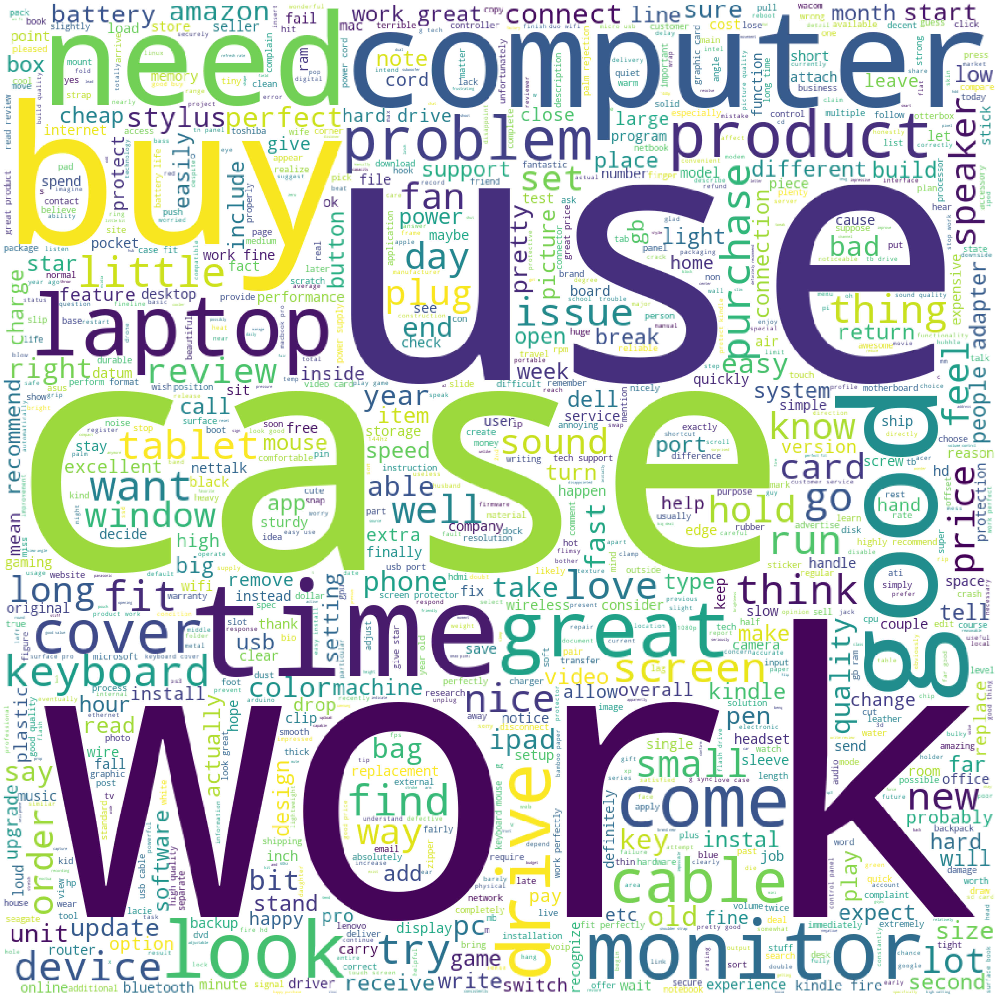

Electronics Warranties


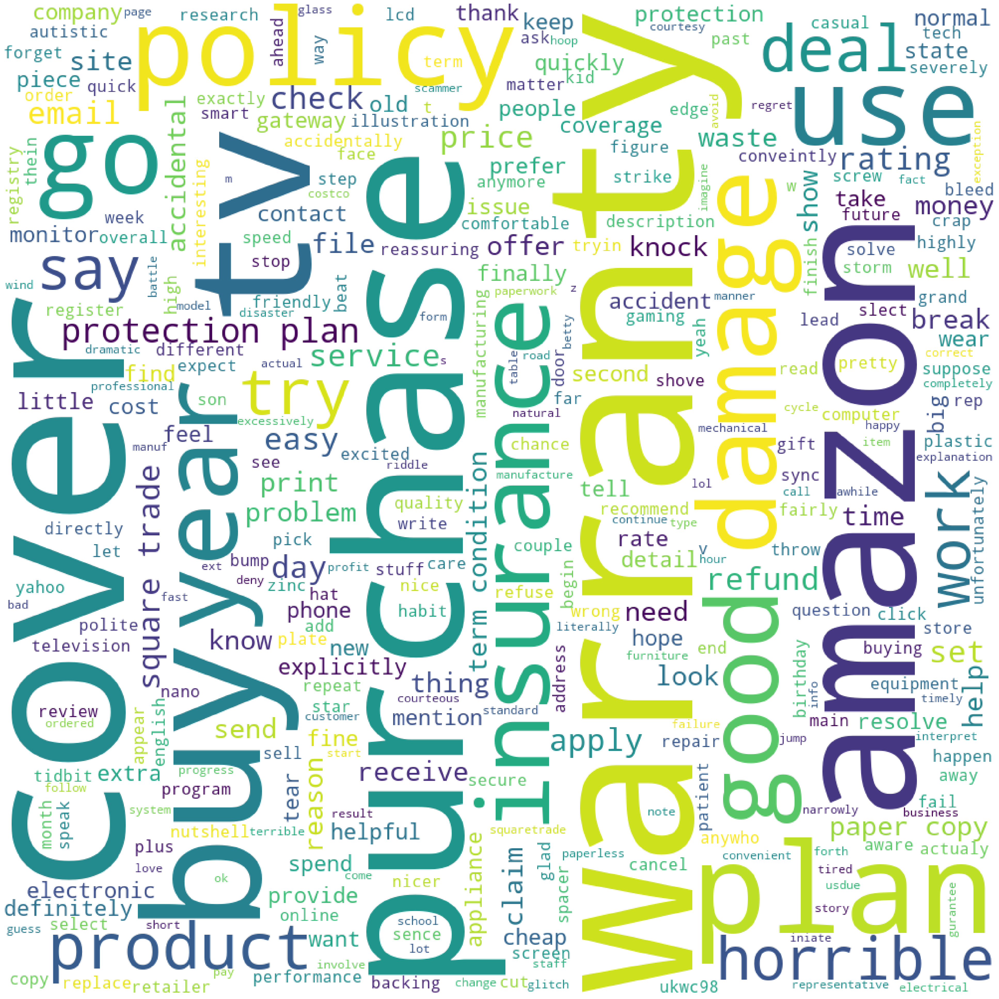

GPS, Finders & Accessories


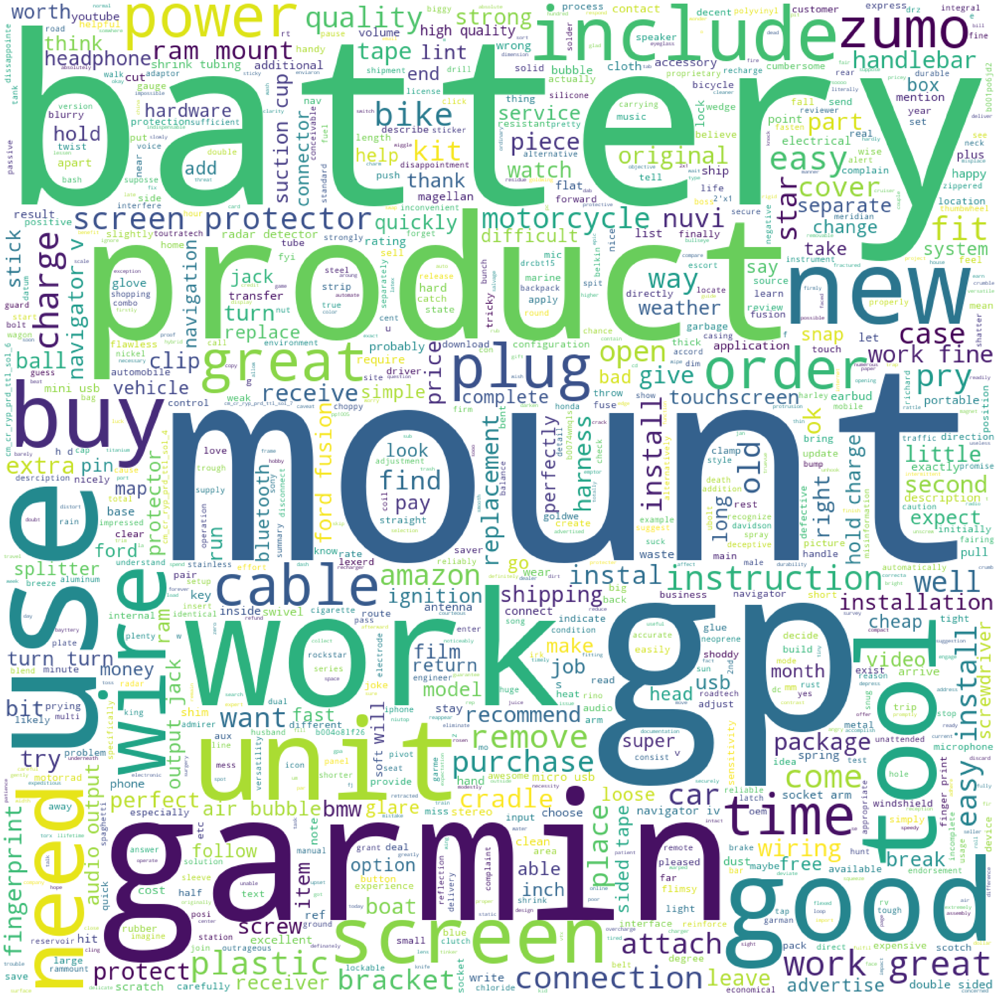

Headphones


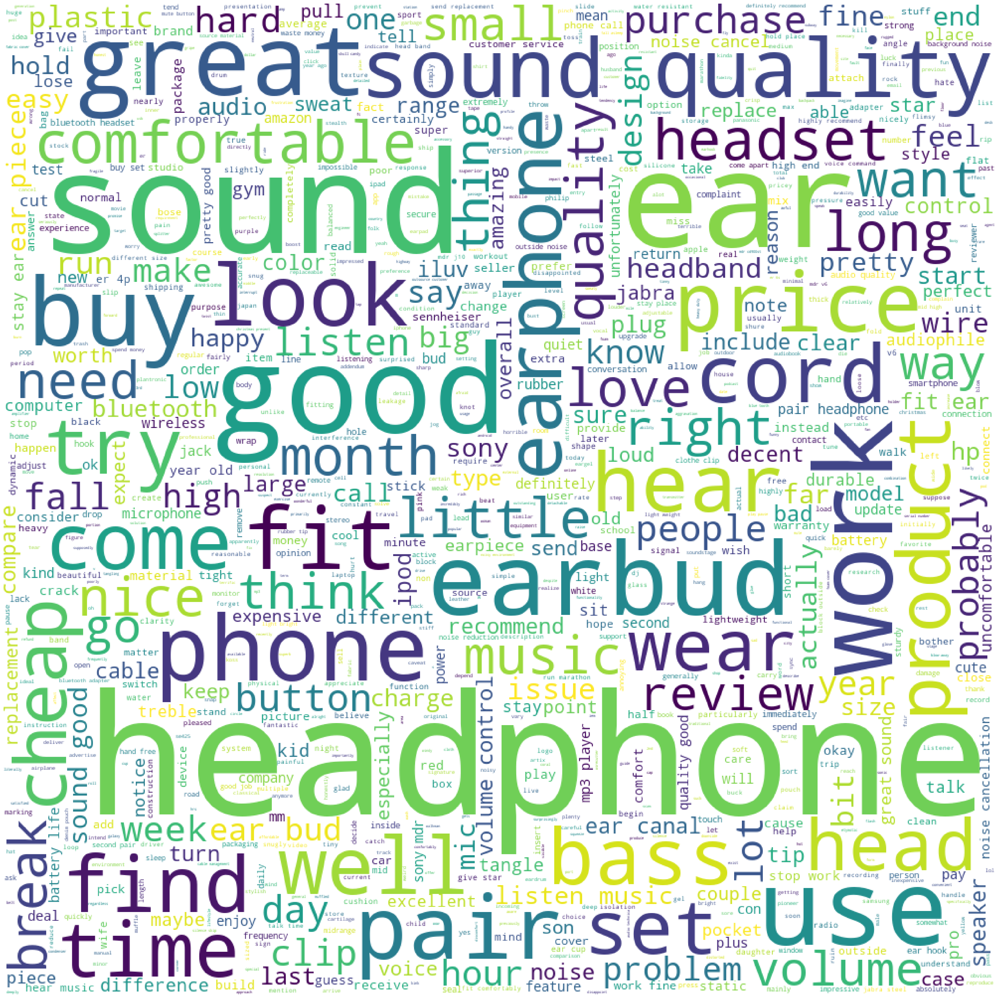

Home Audio


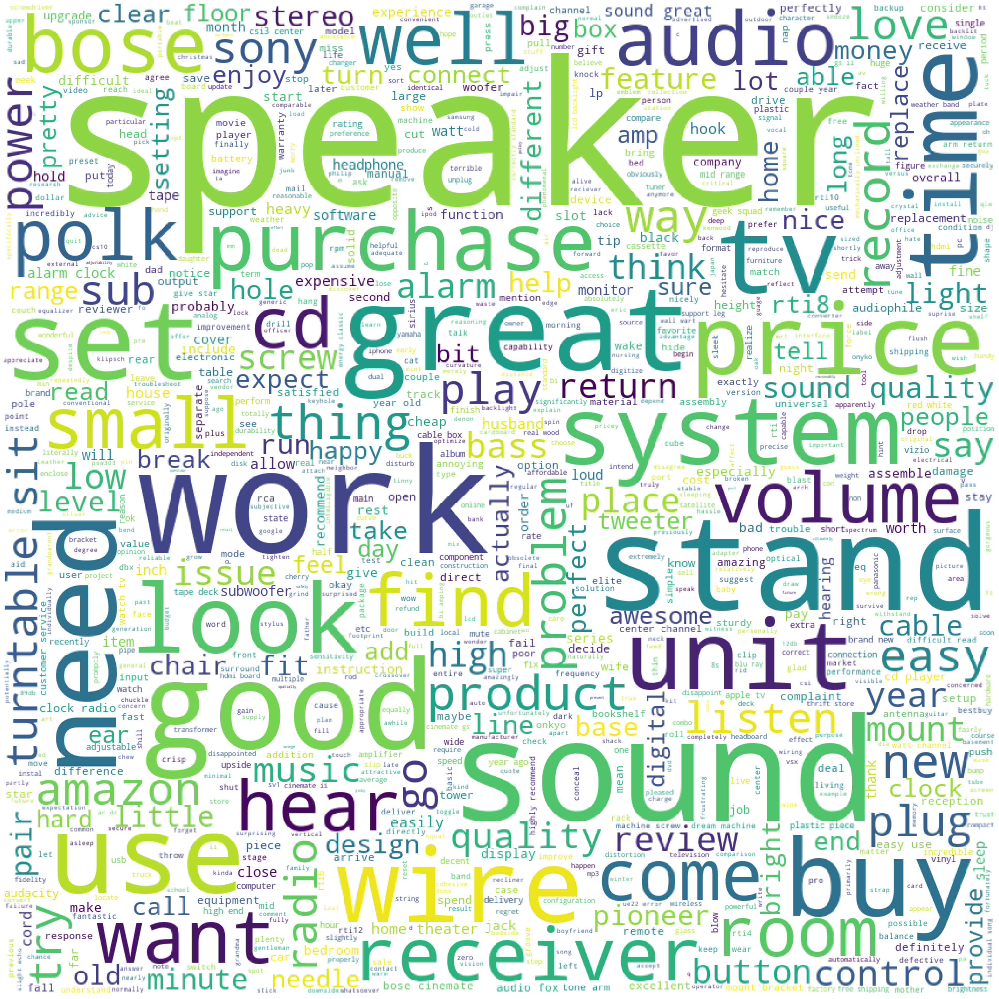

Portable Audio & Video


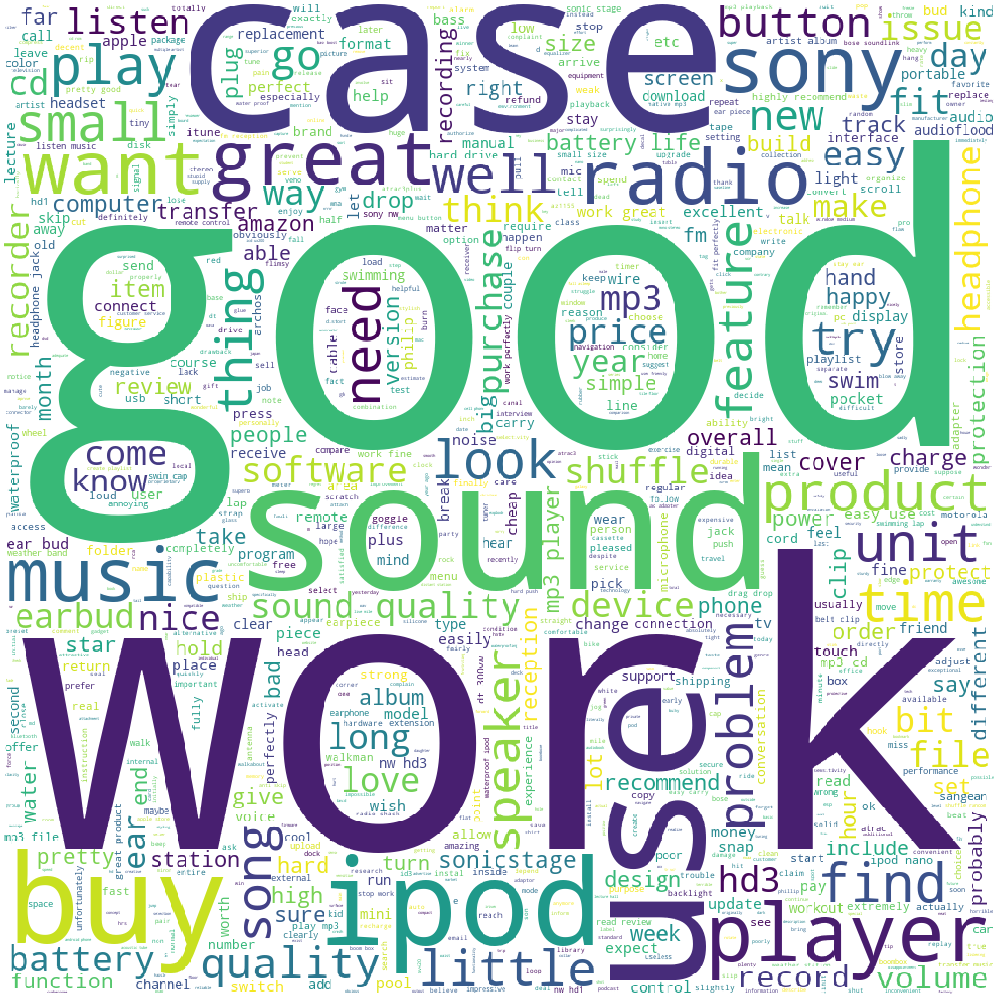

Security & Surveillance


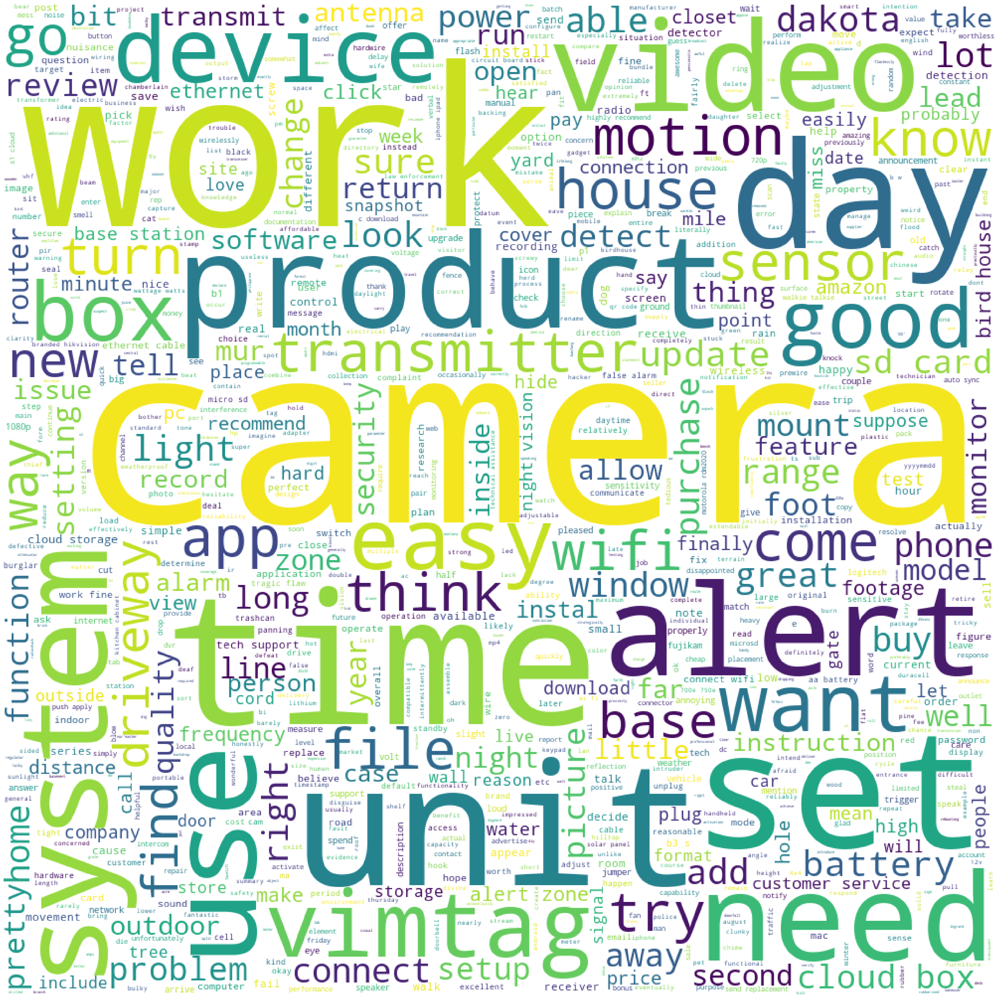

Television & Video


KeyboardInterrupt: 

In [126]:
for cat in category_tokens.index:
    print (cat)
    wordcloud = WordCloud(stopwords=STOPWORDS, background_color="white", max_words=1000,
                         width=1000, height=1000).generate(category_tokens[cat])
    rcParams['figure.figsize'] = 50,50
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.show()

In [127]:
tokens_df = merged_df[['rating', 'tokens']].copy()
tokens_df['tokens'] = tokens_df['tokens'].apply(lambda x: ' '.join(x))
rating_tokens = tokens_df.groupby('rating').tokens.agg(lambda x: ' '.join(x.to_list()))
rating_tokens

rating
1.0    work give zero star packaging description exte...
2.0    lg g3 love quality watch video love transfer l...
3.0    sure adapter slow charger tablet battery drain...
4.0    work work substandard hdmi cable give trouble ...
5.0    give gift brother teach sunday school need ext...
Name: tokens, dtype: object

1.0


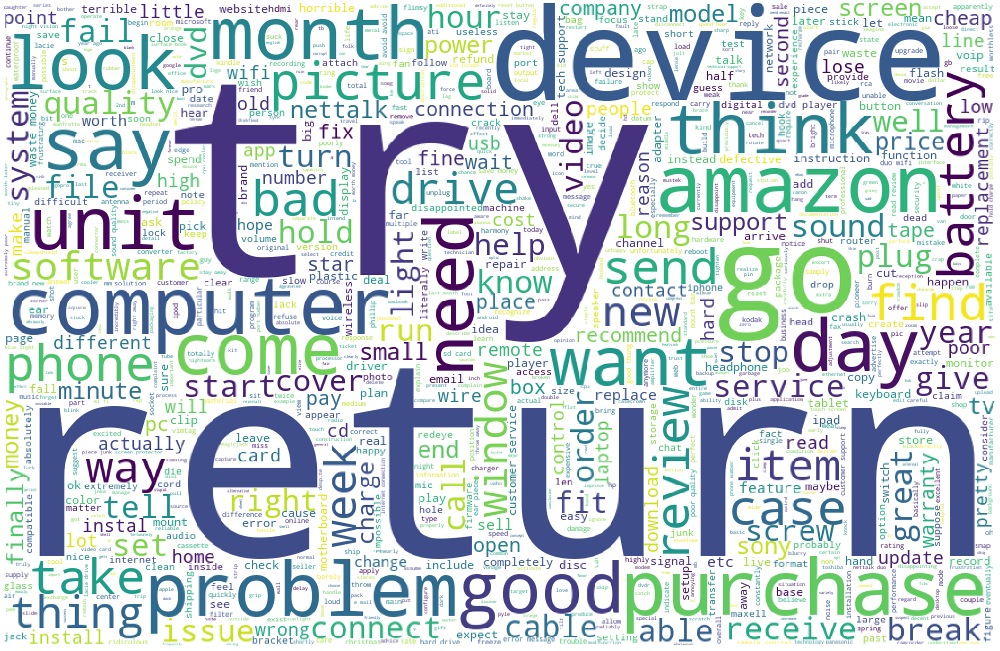

2.0


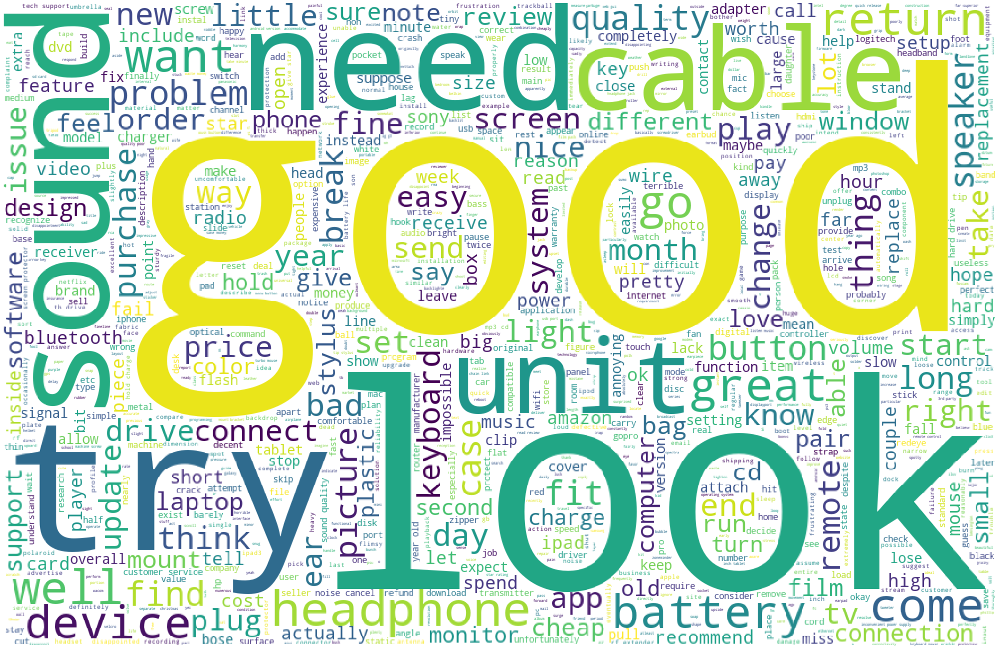

3.0


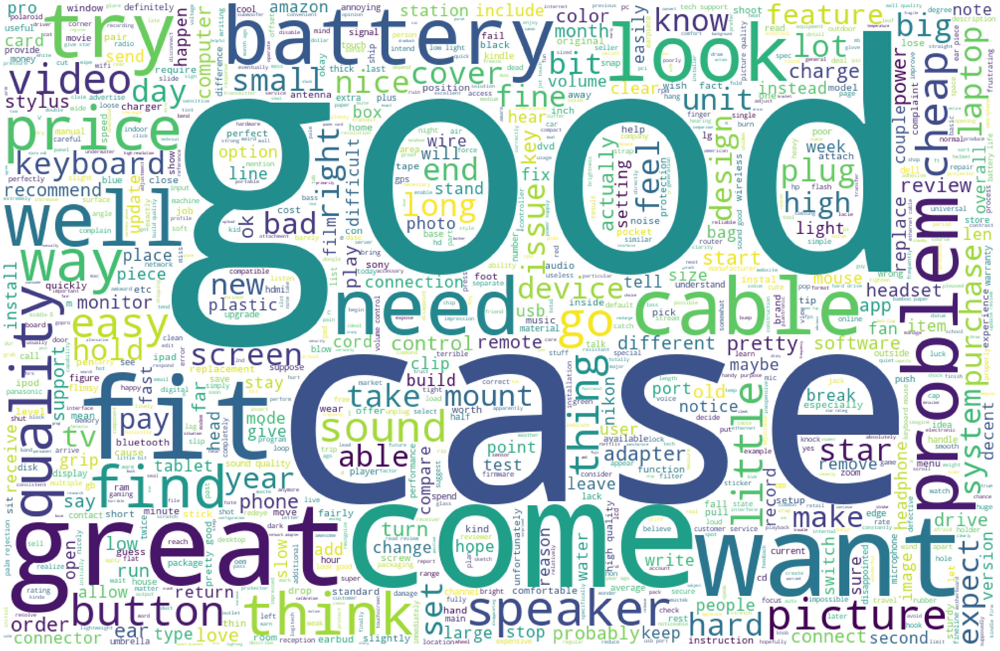

4.0


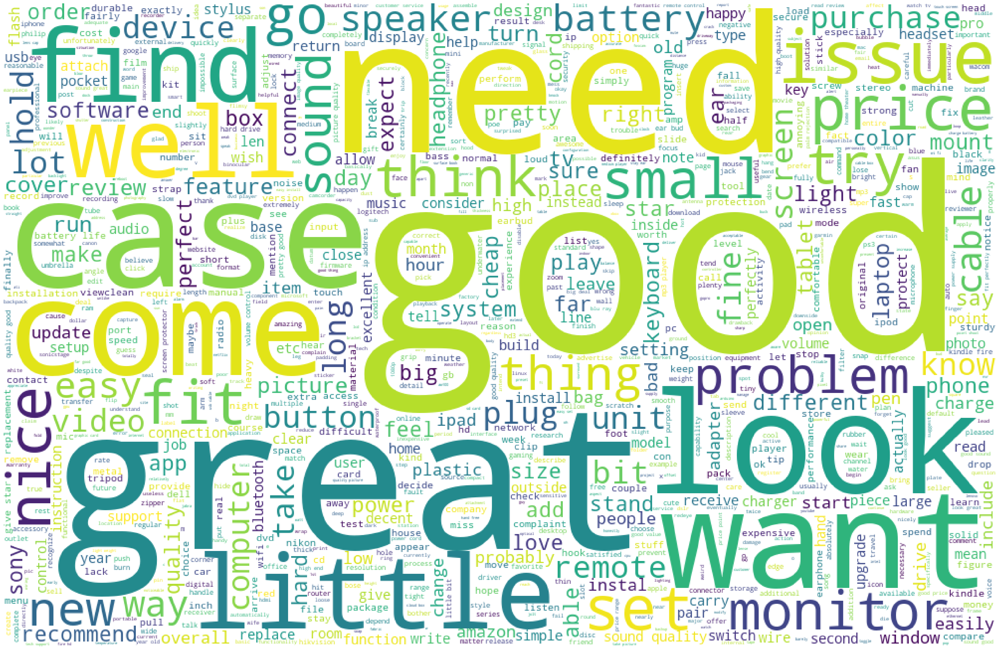

5.0


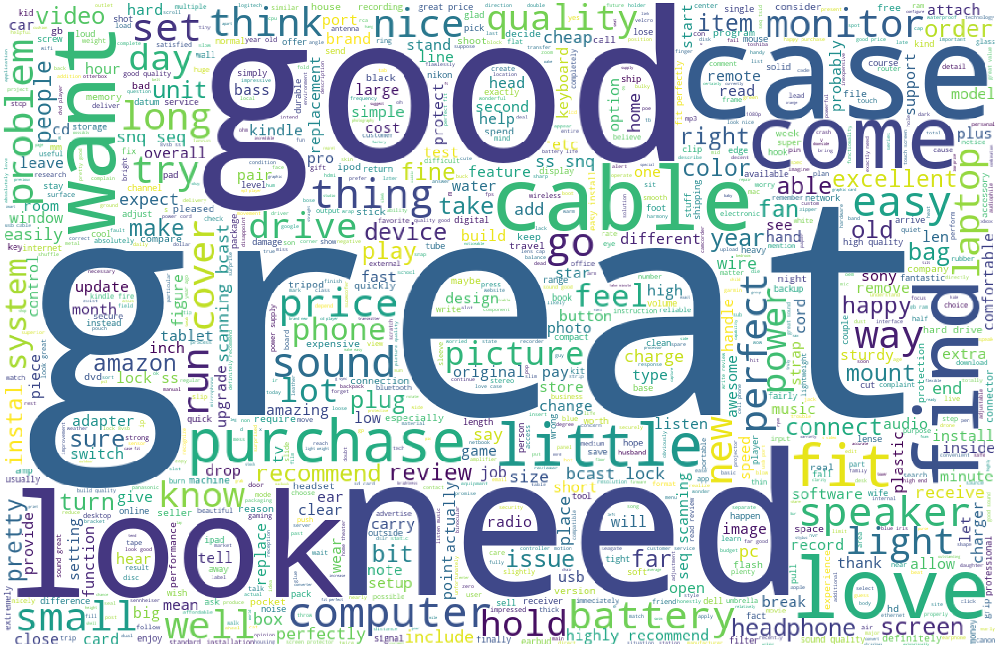

In [134]:
for rat in rating_tokens.index:
    print (rat)
    wordcloud = WordCloud(stopwords=STOPWORDS, background_color="white", max_words=1000,
                         width=1000, height=650).generate(rating_tokens[rat])
    rcParams['figure.figsize'] = 50,50
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.show()
    wordcloud.to_file('rating_{}.png'.format(rat))

Accessories & Supplies


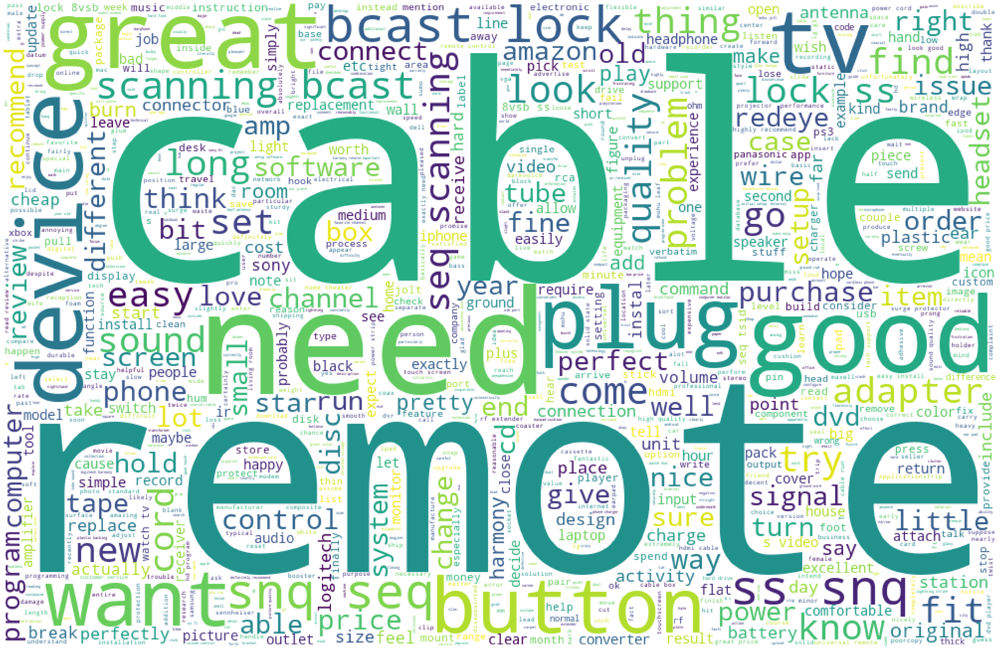

Camera & Photo


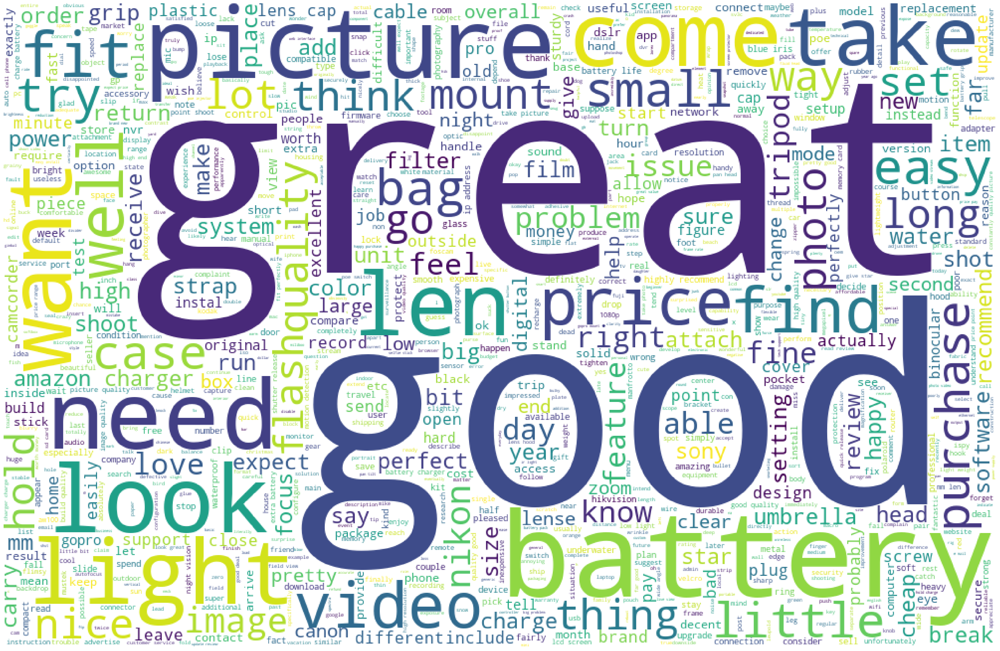

Car & Vehicle Electronics


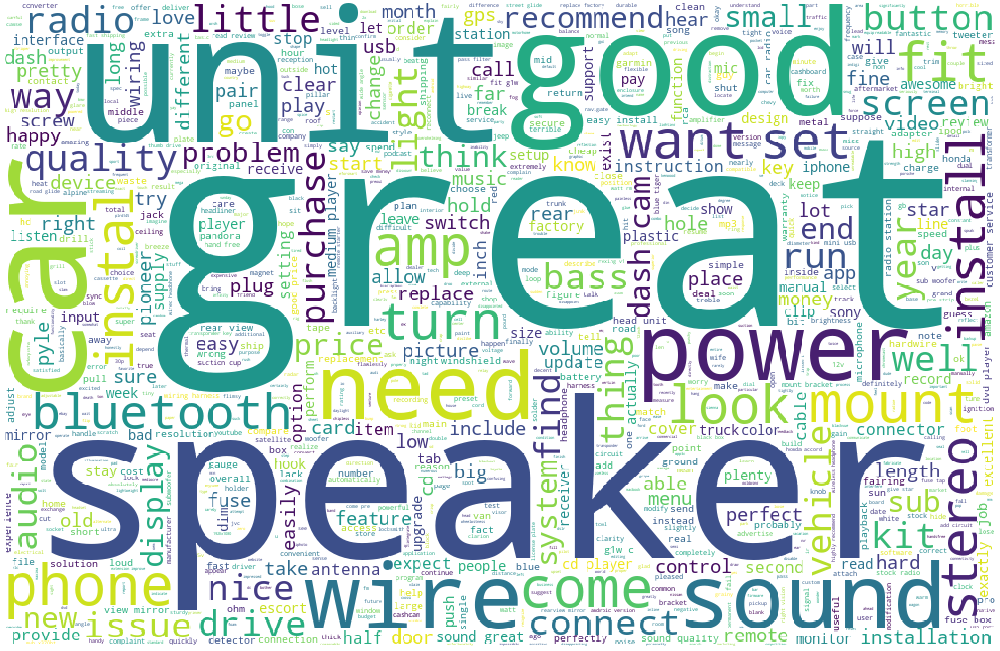

Computers & Accessories


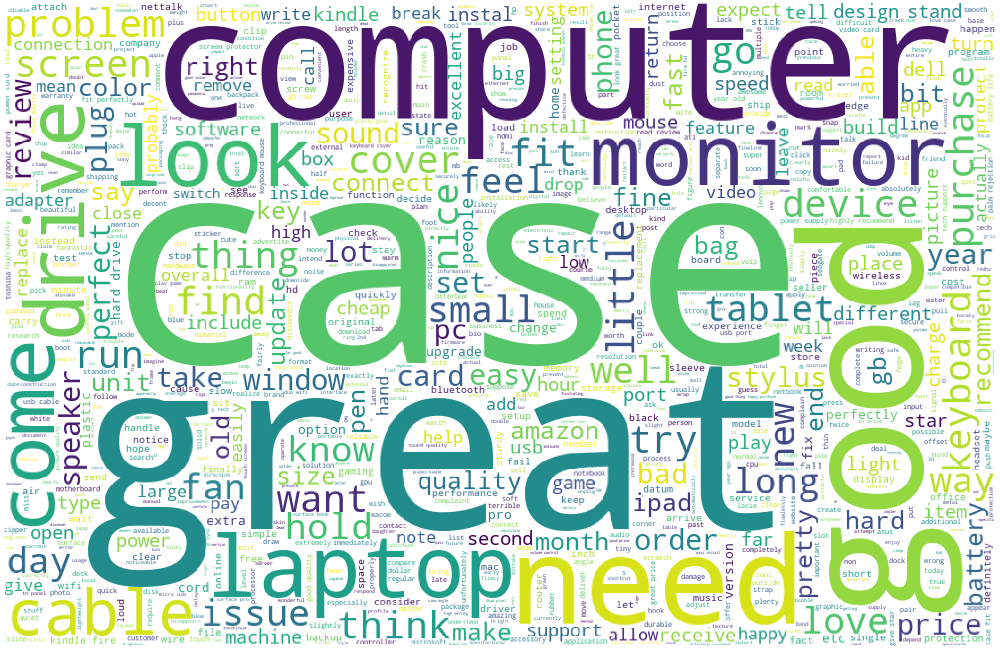

Electronics Warranties


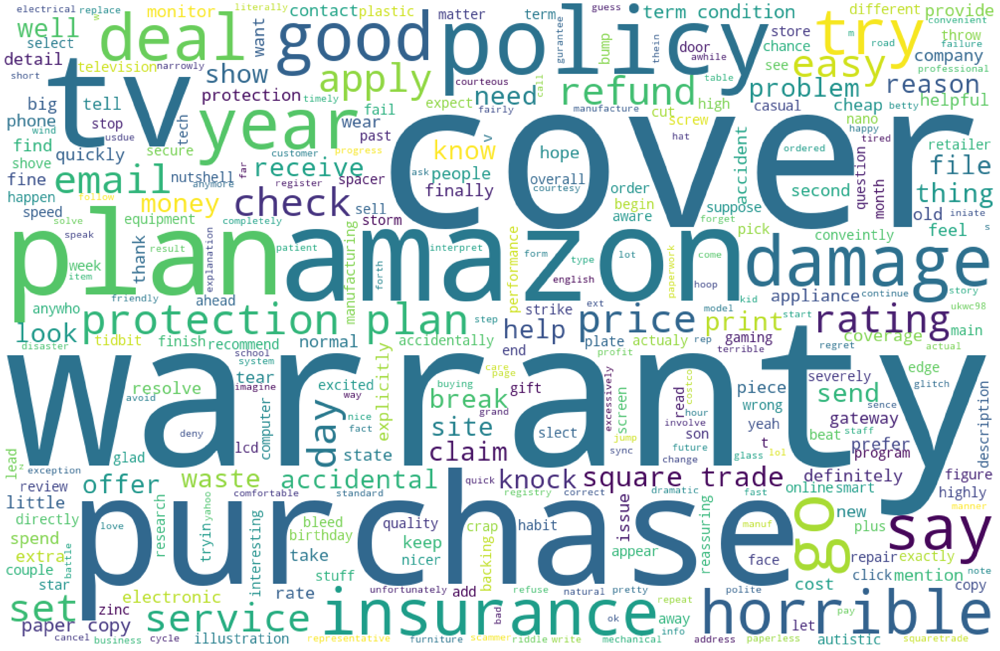

GPS, Finders & Accessories


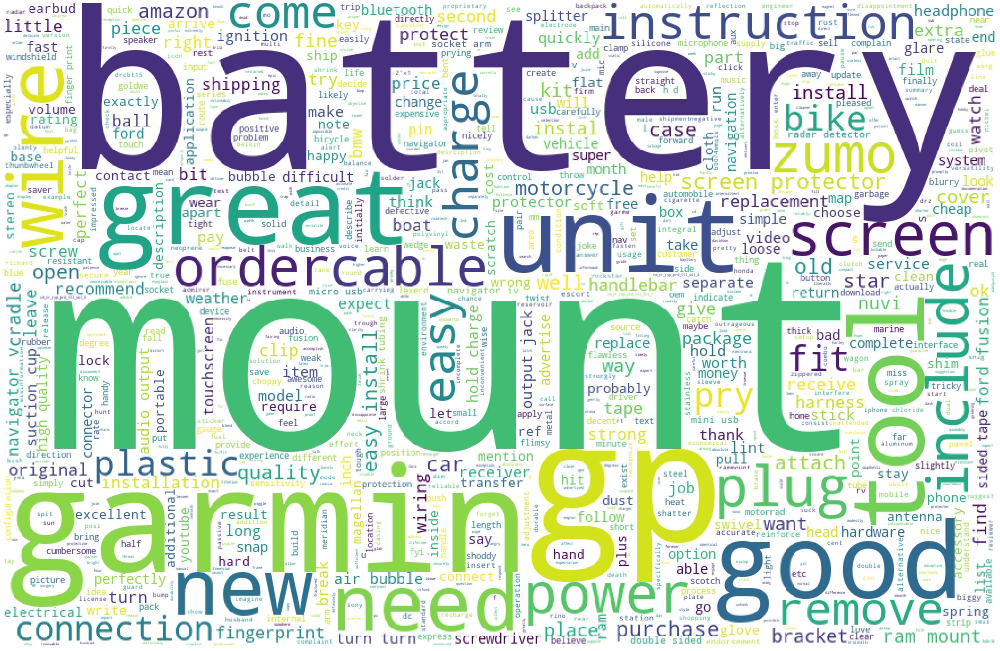

Headphones


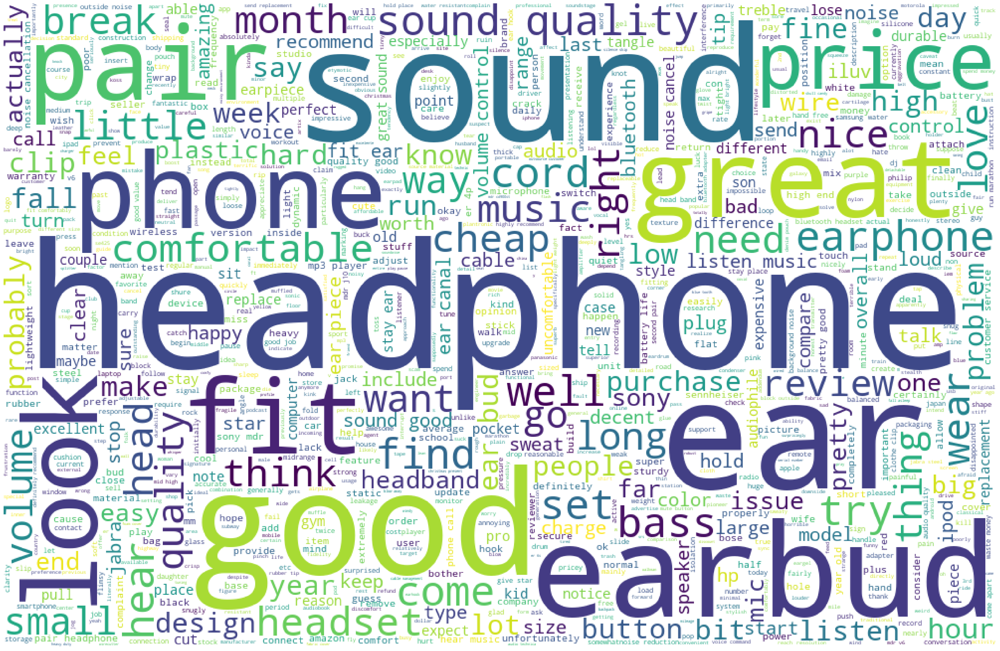

Home Audio


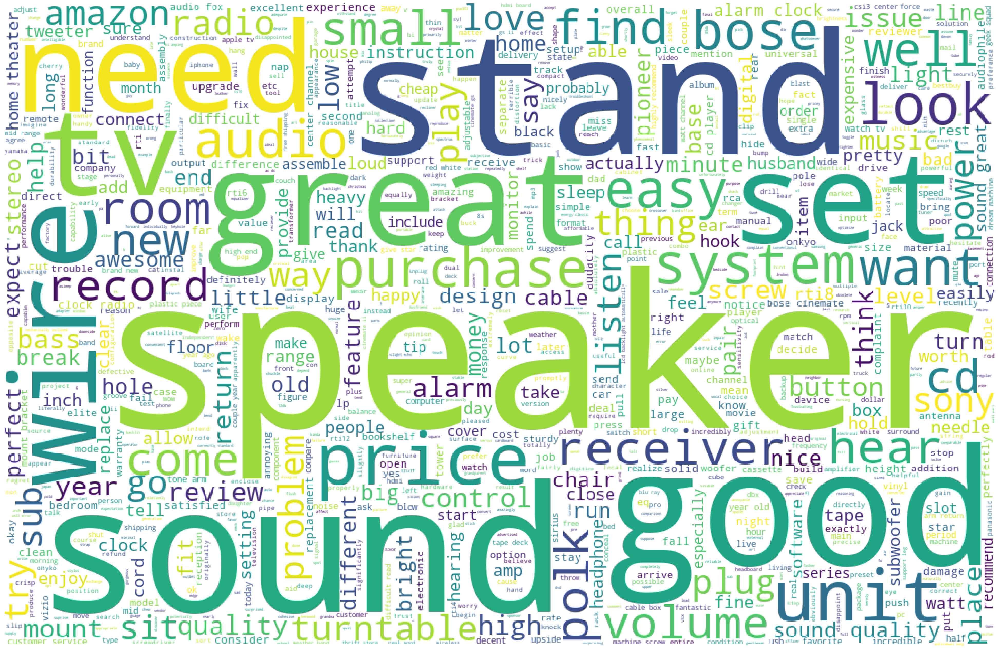

Portable Audio & Video


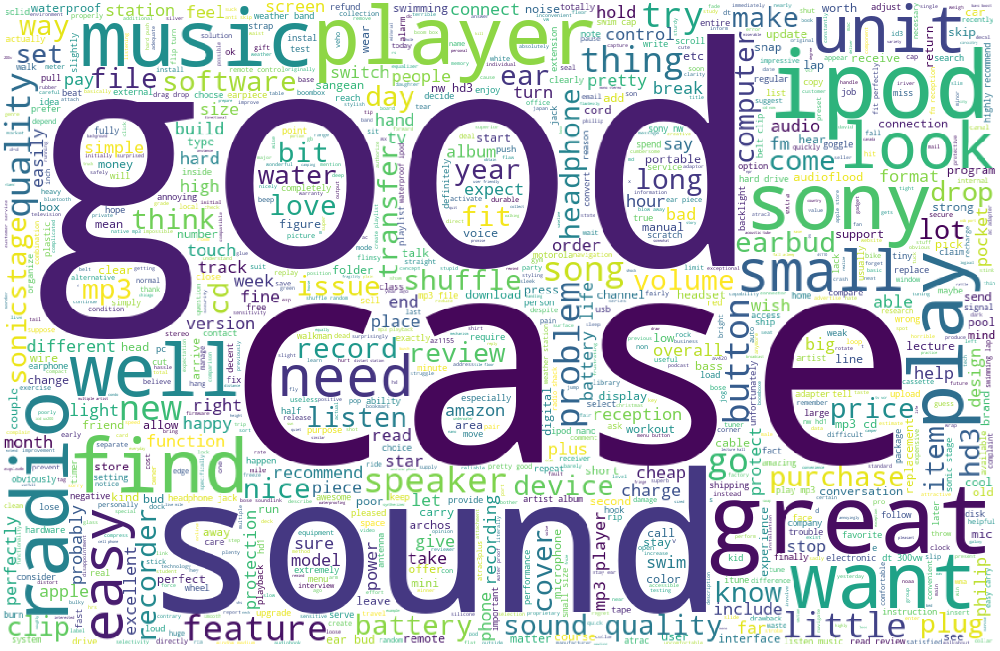

Security & Surveillance


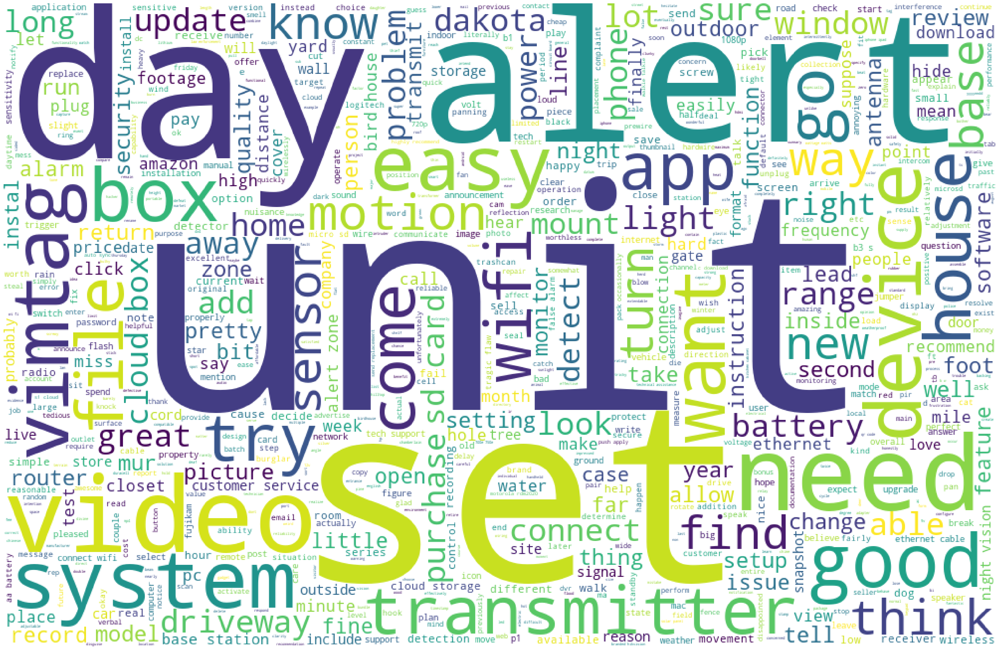

Television & Video


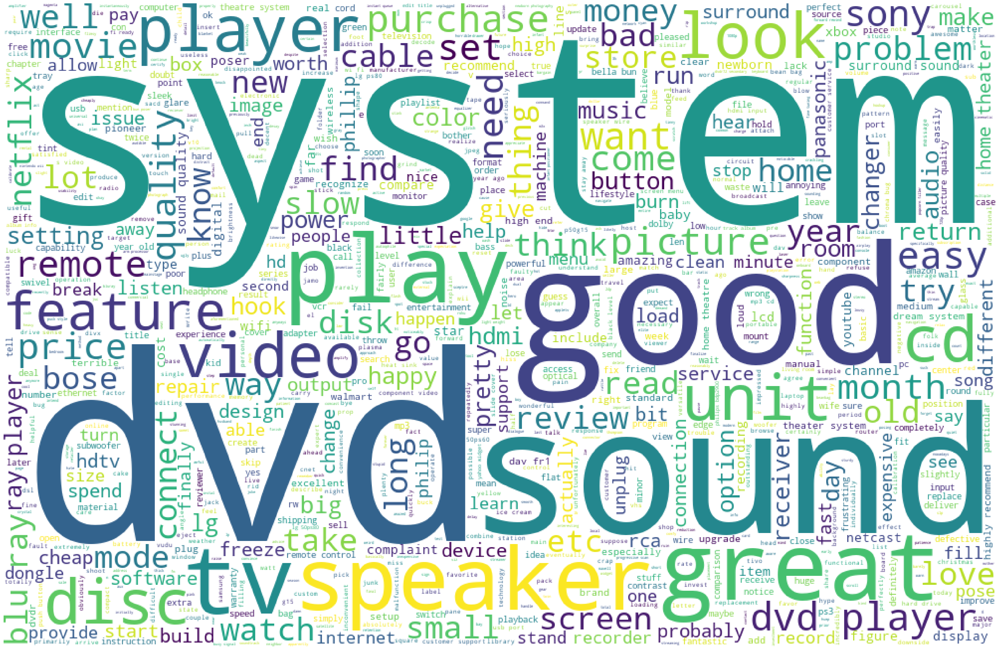

Video Projectors


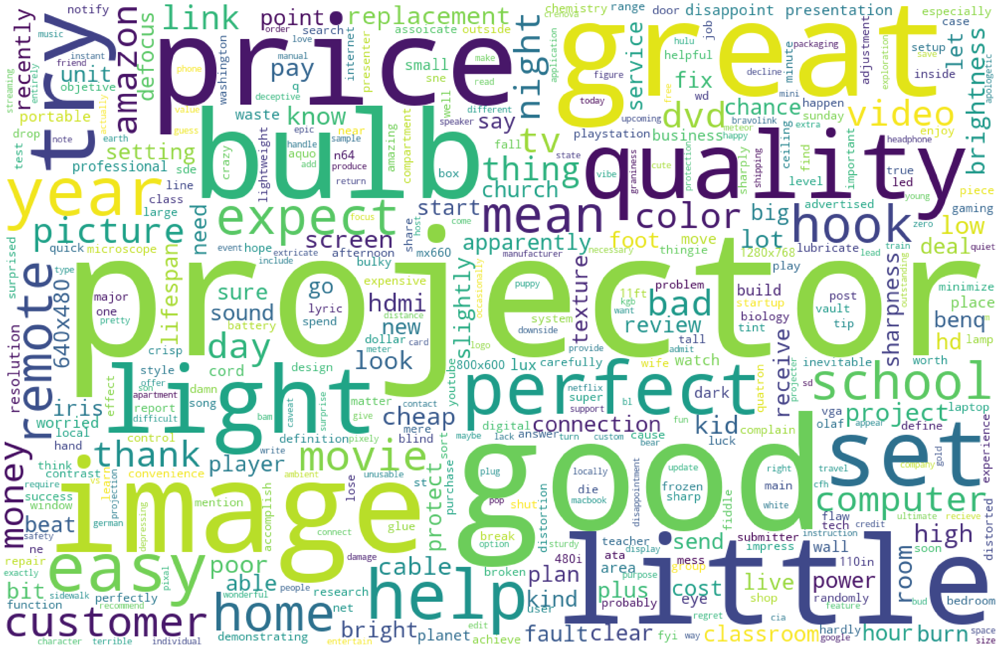

Wearable Technology


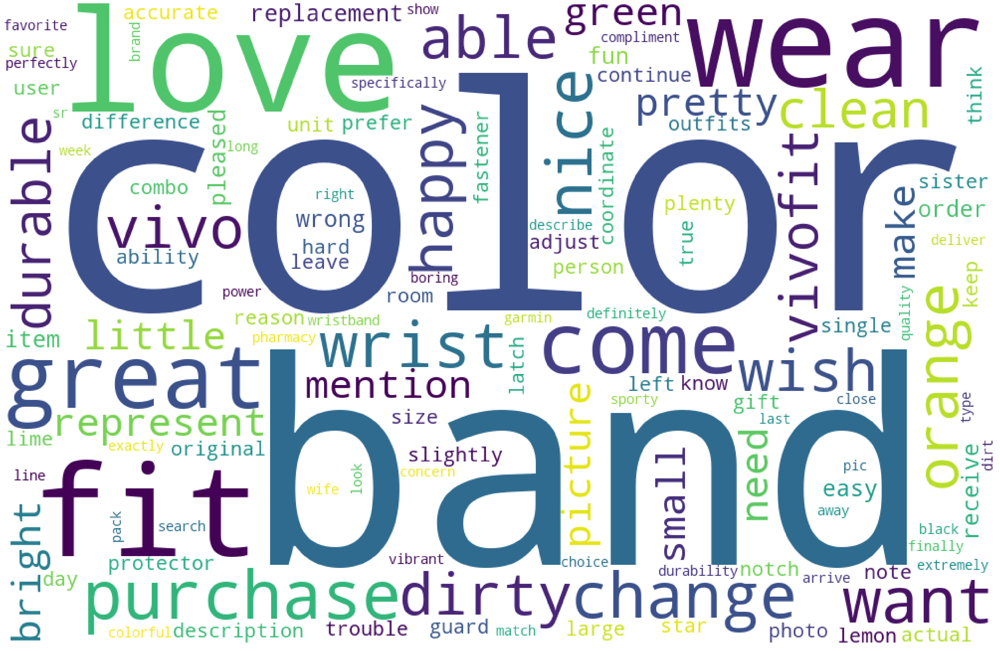

eBook Readers & Accessories


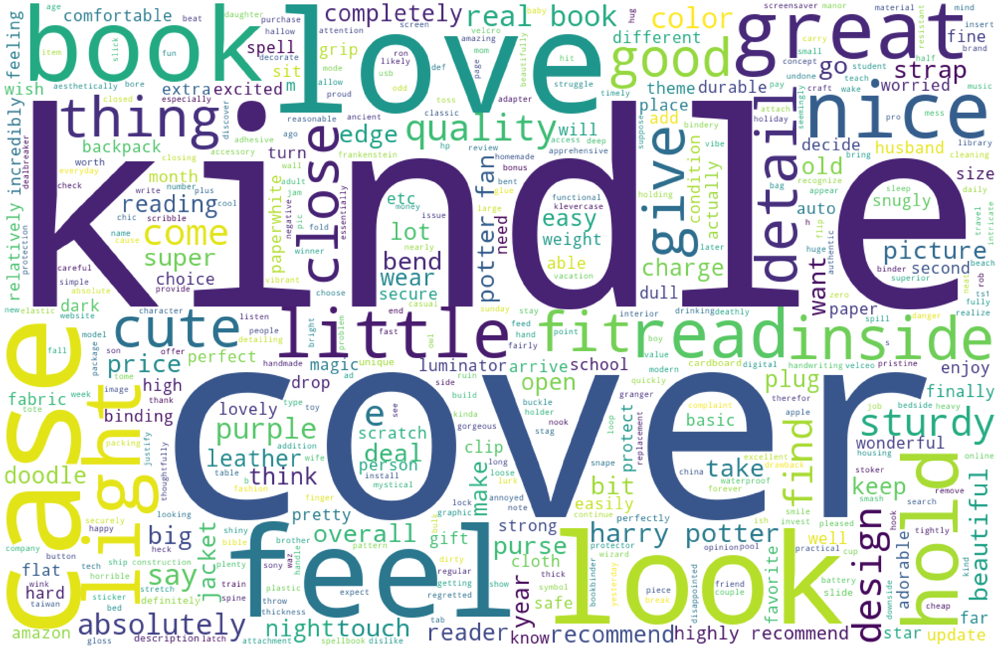

In [132]:
stopwords = STOPWORDS.update(['work', 'time', 'buy', 'product','use', 'camera'])
for cat in category_tokens.index:
    print (cat)
    
    wordcloud = WordCloud(stopwords=STOPWORDS, relative_scaling=0.3, background_color="white", max_words=1000,
                         width=1000, height=650).generate(category_tokens[cat])
    rcParams['figure.figsize'] = 50,50
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.show()
    wordcloud.to_file('category_{}.png'.format(cat))

In [ ]:
#most frequent words for each rating

In [ ]:
# common words in each category


In [ ]:
#wordmap

In [162]:
df = pd.DataFrame({
    "a" : [1,2,3],
    "b" : [[1,2],[2,3,4],[5]],
    "c" : [5,6,7]
})
df

,a,b,c
0,1,"[1, 2]",5
1,2,"[2, 3, 4]",6
2,3,[5],7


In [167]:
df.b.str.len()

0    2
1    3
2    1
Name: b, dtype: int64

In [90]:
merged_df.brand.sample(10)

4434      UPBRIGHT
5200        Kastar
5765       Lechely
2164      Fotodiox
5477    Mei Chen M
5280      CoolBELL
666            C2G
5366    KleverCase
4924           DJI
5818    HENGYONGTA
Name: brand, dtype: object

In [88]:
freq_brands_15 = merged_df.brand.value_counts().sort_values(ascending=False)[:15].reset_index().rename(columns={'index': 'brand_name', 'brand': 'counts'})
freq_brands_15

,brand_name,counts
0,Sony,262
1,Dell,73
2,Philips,70
3,HP,61
4,Garmin,59
5,Nikon,57
6,Pioneer,53
7,MaximalPower,48
8,StarTech,47
9,uxcell,44


In [91]:
fig = px.bar(freq_brands_15, x='brand_name', y='counts', text_auto=True)
fig.update_layout(
    title_text='Number of reviews for the top 15 brands'
)

In [92]:
fig.write_html('plot_brand_freq.html',
                full_html=False,
                include_plotlyjs='cdn')

In [94]:
brand_rating_15 = merged_df.loc[merged_df.brand.isin(freq_brands_15['brand_name']), ['brand', 'rating']]

In [95]:
fig = px.box(brand_rating_15, x='brand', y='rating')
fig.update_layout(
    title_text='Box plot for ratings in each brand'
)
fig.show()

In [96]:
fig.write_html('plot_brand_rating_box.html',
                full_html=False,
                include_plotlyjs='cdn')

In [98]:
brand_rating_freq = brand_rating_15.groupby(['brand', 'rating']).agg(count=('brand', 'count')).reset_index()
brand_rating_freq

,brand,rating,count
0,Belkin,2.0,6
1,Belkin,3.0,1
2,Belkin,4.0,16
3,Belkin,5.0,21
4,Dell,1.0,10
...,...,...,...
65,uxcell,1.0,4
66,uxcell,2.0,7
67,uxcell,3.0,8
68,uxcell,4.0,17


In [99]:
fig = px.scatter(brand_rating_freq, x='brand', y='rating', size='count')
fig.update_layout(
    title_text='Scatter plot of rating vs brand with the bubble size indicating the number of reviews'
)

In [100]:
fig.write_html('plot_brand_rating_bubble.html',
                full_html=False,
                include_plotlyjs='cdn')

In [101]:
category_verified_pur = merged_df[['category_1', 'verified_purchase']].value_counts().rename('counts').reset_index()
category_verified_pur

,category_1,verified_purchase,counts
0,Computers & Accessories,True,1879
1,Camera & Photo,True,1264
2,Accessories & Supplies,True,865
3,Headphones,True,294
4,Car & Vehicle Electronics,True,238
5,Portable Audio & Video,True,221
6,Computers & Accessories,False,218
7,Camera & Photo,False,149
8,Home Audio,True,129
9,"GPS, Finders & Accessories",True,113


In [102]:
# merged_df
fig = px.sunburst(
    category_verified_pur,
    path=['category_1', 'verified_purchase'],
    values='counts'
)
fig.update_layout(
    title_text='Pie chart with categories and verified_purchase levels'
)

fig.show()

In [103]:
fig.write_html('plot_category_verified_pie.html',
                full_html=False,
                include_plotlyjs='cdn')

In [411]:
merged_df

,category,description,title_x,also_buy,brand,feature,rank,also_view,main_cat,date_x,...,asin,title_y,content,date_y,author,rating,found_helpful,verified_purchase,product,category_1
0,"[Electronics, Computers & Accessories, Tablet ...",Brand new and high quality\nLightweight soft c...,PU Leather 360 Degree Rotating Stand Case Cove...,[],new brand,Brand new and high quality Lightweight soft ca...,[[Computers & Accessories > Tablet Accessories...,[],Computers,2012-11-23,...,1039869017,love it!!,"This cover was an amazing deal, not only does ...",2013-03-08,lorena mahoney,5.0,1,True,Yellow Protective Silicone Gel Slim Thin Back ...,Computers & Accessories
1,"[Electronics, Computers & Accessories, Tablet ...",Brand new and high quality\nLightweight soft c...,PU Leather 360 Degree Rotating Stand Case Cove...,[],new brand,Brand new and high quality Lightweight soft ca...,[[Computers & Accessories > Tablet Accessories...,[],Computers,2012-11-23,...,1039869017,Works fine,Works great. Has a obviously fake leather exte...,2013-09-05,Alex P,5.0,0,True,Yellow Protective Silicone Gel Slim Thin Back ...,Computers & Accessories
2,"[Electronics, Headphones]",This beautifully illustrated children's book t...,The Legend of the Starfish,[],The Joy Market,,"[[Cell Phones & Accessories , 1,053,995], [Cel...",[],Cell Phones & Accessories,NaT,...,1944288023,but I sure enjoyed it myself,"This may be a kids book, but I sure enjoyed it...",2016-04-22,RedCurlz,5.0,0,False,The Legend of the Starfish,Headphones
3,"[Electronics, Headphones]",This beautifully illustrated children's book t...,The Legend of the Starfish,[],The Joy Market,,"[[Cell Phones & Accessories , 1,053,995], [Cel...",[],Cell Phones & Accessories,NaT,...,1944288023,Such a great book! The illustrations are beaut...,Such a great book! The illustrations are beaut...,2016-04-19,Micah Wood,5.0,1,False,The Legend of the Starfish,Headphones
4,"[Electronics, Headphones]",This beautifully illustrated children's book t...,The Legend of the Starfish,[],The Joy Market,,"[[Cell Phones & Accessories , 1,053,995], [Cel...",[],Cell Phones & Accessories,NaT,...,1944288023,Add to your library!,"Whimsical, poignant, a breath of fresh air. A ...",2016-04-19,KAT,5.0,1,False,The Legend of the Starfish,Headphones
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5892,"[Electronics, Car & Vehicle Electronics, Car E...",Feature : G-sensor function and motion detecti...,Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7&...,[],Lecmal,3\n3\n3\n3\n3,"[[Electronics , 163,429], [Electronics > Car E...",[],Car Electronics,2016-06-22,...,B01HEKL4KI,Its good for they price,"Its good for they price, i just wish it had a ...",2016-08-29,Remo,4.0,0,True,"Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7""...",Car & Vehicle Electronics
5893,"[Electronics, Car & Vehicle Electronics, Car E...",Feature : G-sensor function and motion detecti...,Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7&...,[],Lecmal,3\n3\n3\n3\n3,"[[Electronics , 163,429], [Electronics > Car E...",[],Car Electronics,2016-06-22,...,B01HEKL4KI,I like this product,"I like this product , but it is hard to use af...",2017-11-25,Donna B,4.0,0,True,"Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7""...",Car & Vehicle Electronics
5894,"[Electronics, Car & Vehicle Electronics, Car E...",Feature : G-sensor function and motion detecti...,Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7&...,[],Lecmal,3\n3\n3\n3\n3,"[[Electronics , 163,429], [Electronics > Car E...",[],Car Electronics,2016-06-22,...,B01HEKL4KI,... DVR is Ok for the money daytime it works g...,This little DVR is Ok for the money daytime it...,2016-08-20,Hawk,4.0,2,True,"Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7""...",Car & Vehicle Electronics
5895,"[Electronics, Car & Vehicle Electronics, Car E...",Feature : G-sensor function and motion detecti...,Lecmal ix-se3-2 GS8000 DVR Recorder 1080P/2.7&...,[],Lecmal,3\n3\n3\n3\n3,"[[Electronics , 163,429], [Electronics > Car E...",[],Car 

In [413]:
merged_df.found_helpful.value_counts()

0      3570
1       947
2       420
3       234
4       133
       ... 
89        1
118       1
75        1
65        1
275       1
Name: found_helpful, Length: 75, dtype: int64

In [104]:
fig = px.scatter(merged_df, color='rating', y='found_helpful', x='category_1')
fig.update_layout(
    title_text='Scatter plot of found_helpful vs category with color as the rating'
)

In [105]:
fig.write_html('plot_found_helpful_catgory_rating_scatter.html',
                full_html=False,
                include_plotlyjs='cdn')

In [106]:
helpful_votes = merged_df.loc[merged_df.found_helpful != 0, ['category_1', 'rating', 'found_helpful']].copy()

In [107]:
helpful_votes['found_helpful_bins'] = pd.cut(helpful_votes.found_helpful, [0,1,2,3,4,6,11,399])

In [108]:
helpful_votes = helpful_votes.drop(columns='found_helpful').value_counts().rename('count').reset_index()



In [109]:
helpful_votes['found_helpful_bins'] = helpful_votes['found_helpful_bins'].astype(str)
helpful_votes['rating'] = helpful_votes['rating'].astype(str)

helpful_votes

,category_1,rating,found_helpful_bins,count
0,Computers & Accessories,5.0,"(0, 1]",172
1,Camera & Photo,5.0,"(0, 1]",105
2,Accessories & Supplies,5.0,"(0, 1]",70
3,Computers & Accessories,5.0,"(1, 2]",65
4,Computers & Accessories,4.0,"(0, 1]",63
...,...,...,...,...
314,Security & Surveillance,3.0,"(3, 4]",1
315,Security & Surveillance,3.0,"(2, 3]",1
316,Security & Surveillance,3.0,"(1, 2]",1
317,Security & Surveillance,3.0,"(0, 1]",1


In [115]:
fig = px.scatter(helpful_votes, x='rating', y='found_helpful_bins', color='category_1', size='count',
          category_orders={'rating': [1.0, 2.0, 3.0, 4.0, 5.0],
                            'found_helpful_bins': ['(0, 1]', '(1, 2]', '(2, 3]', '(3, 4]', '(4, 6]', '(6, 11]', '(11, 399]'][::-1]})

fig.update_layout(
    title_text='Scatter plot of binned found_helpful vs rating with color as the category'
)
fig.show()

In [116]:
fig.write_html('plot_binned_found_helpful_catgory_rating_scatter.html',
                full_html=False,
                include_plotlyjs='cdn')

In [459]:
helpful_votes

,category_1,rating,found_helpful_bins,count
0,Computers & Accessories,5.0,"(0, 1]",163
1,Accessories & Supplies,5.0,"(0, 1]",106
2,Computers & Accessories,4.0,"(0, 1]",88
3,Camera & Photo,5.0,"(0, 1]",82
4,Computers & Accessories,5.0,"(1, 2]",77
...,...,...,...,...
290,Home Audio,1.0,"(2, 3]",1
291,Headphones,4.0,"(3, 4]",1
292,Headphones,3.0,"(4, 6]",1
293,Headphones,2.0,"(11, 399]",1
